In [1]:
#plot setting
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from cycler import cycler

colors = cycler(color=plt.get_cmap("tab10").colors)  # ["b", "r", "g"]

mpl.style.use("ggplot")
mpl.rcParams["figure.figsize"] = (20, 5)
mpl.rcParams["axes.facecolor"] = "white"
mpl.rcParams["axes.grid"] = True
mpl.rcParams["grid.color"] = "lightgray"
mpl.rcParams["axes.prop_cycle"] = colors
mpl.rcParams["axes.linewidth"] = 1
mpl.rcParams["xtick.color"] = "black"
mpl.rcParams["ytick.color"] = "black"
mpl.rcParams["font.size"] = 12
mpl.rcParams["figure.titlesize"] = 25
mpl.rcParams["figure.dpi"] = 100


In [2]:
df = pd.read_pickle("../../data/interim/01_data_processed.pkl")
df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participent,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30
...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,90
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,90
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,90


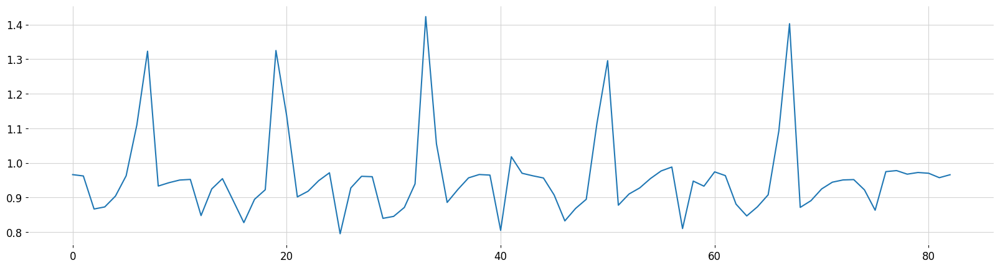

In [7]:
#ploting single column 
'''
We have created a set column seprately now we can analysie on perticular sets
'''
set_df = df[df["set"] == 1]
plt.plot(set_df['acc_y'].reset_index(drop=True))

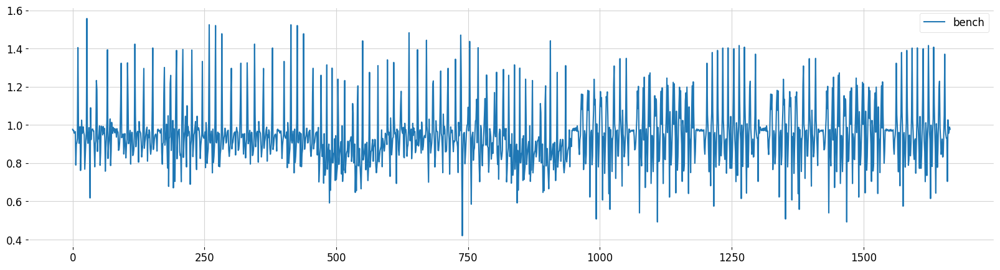

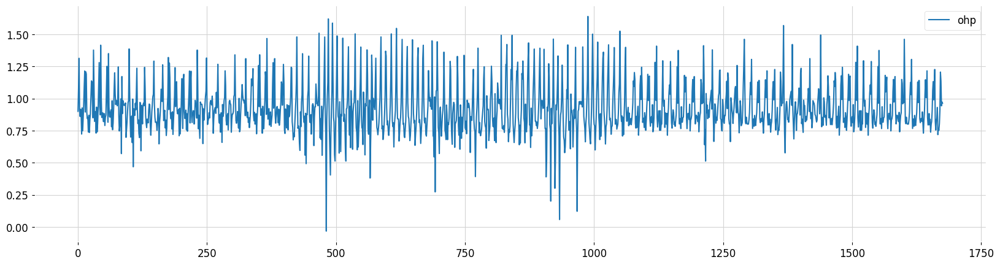

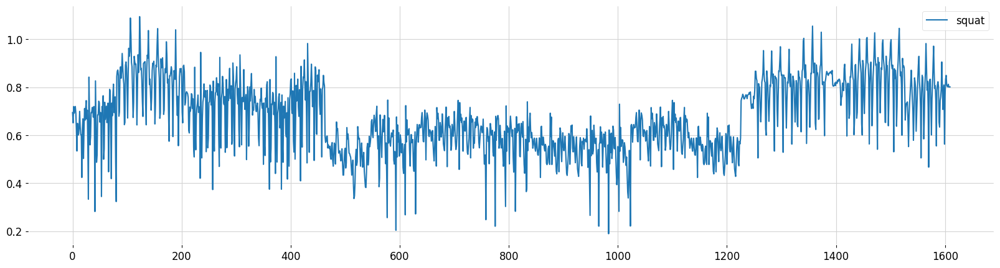

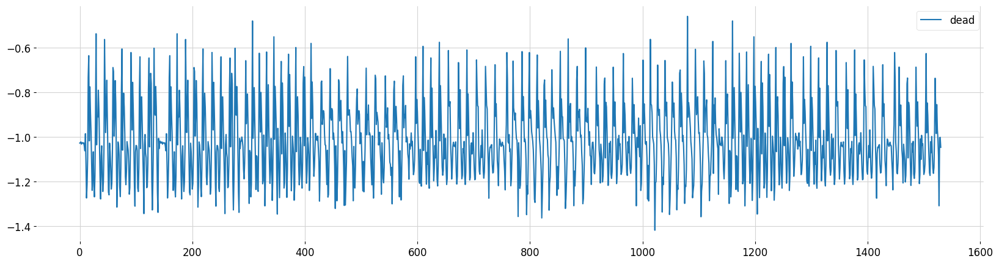

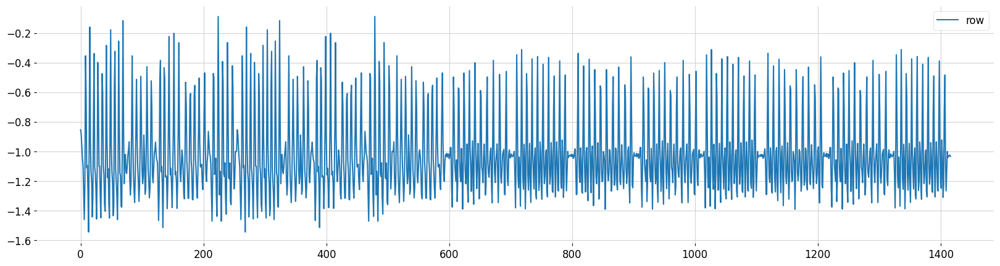

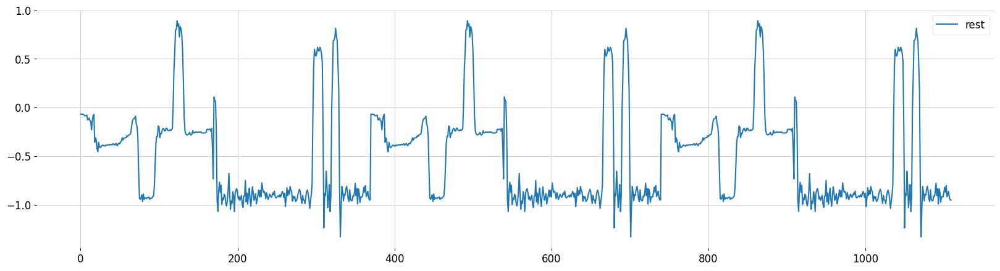

In [12]:
from IPython.display import display  #for displaying datafram in loop

for label in df['label'].unique():
    subset = df[df['label']== label]
    fig, x = plt.subplots()
    plt.plot(subset['acc_y'].reset_index(drop=True), label=label)
    plt.legend()
    plt.show()

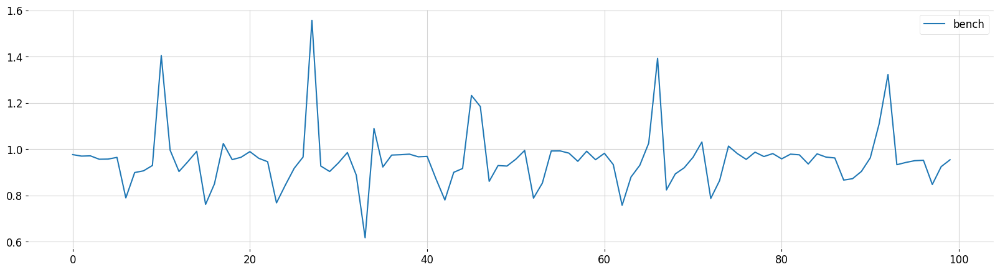

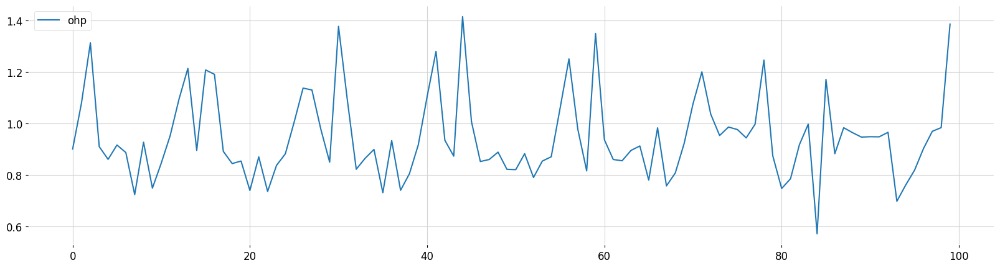

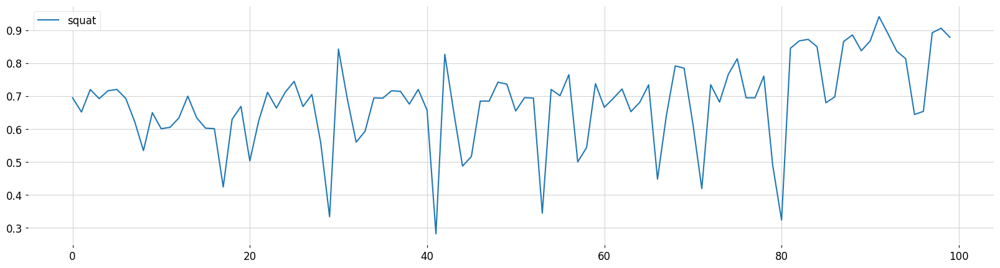

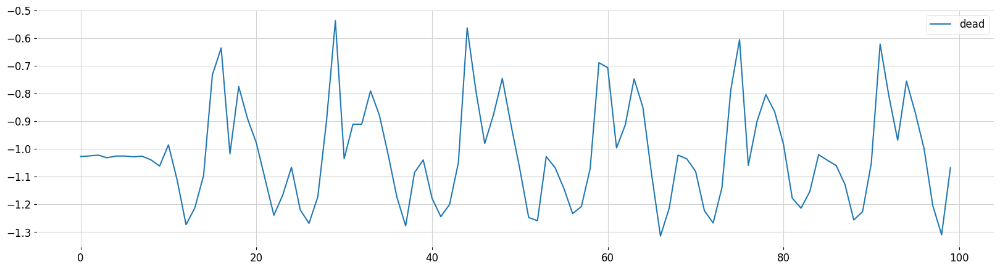

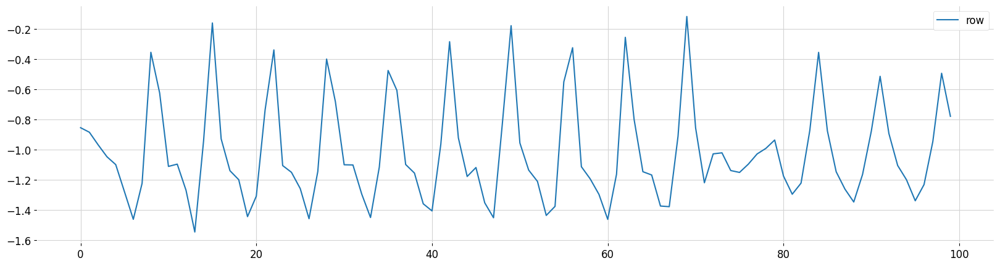

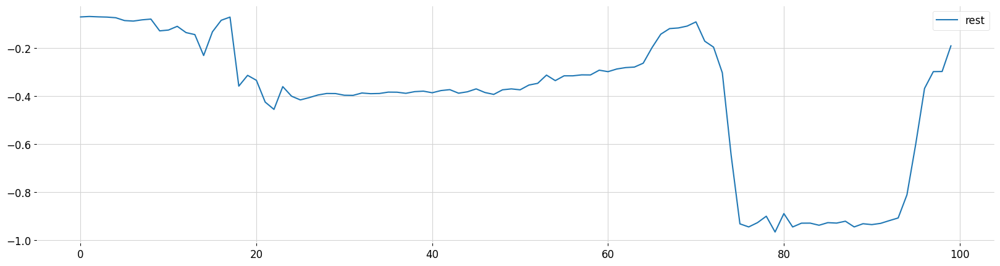

In [13]:
#plot for 100 data to see the patter

for label in df['label'].unique():
    subset = df[df['label']== label]
    fig, x = plt.subplots()
    plt.plot(subset[:100]['acc_y'].reset_index(drop=True), label=label)
    plt.legend()
    plt.show()

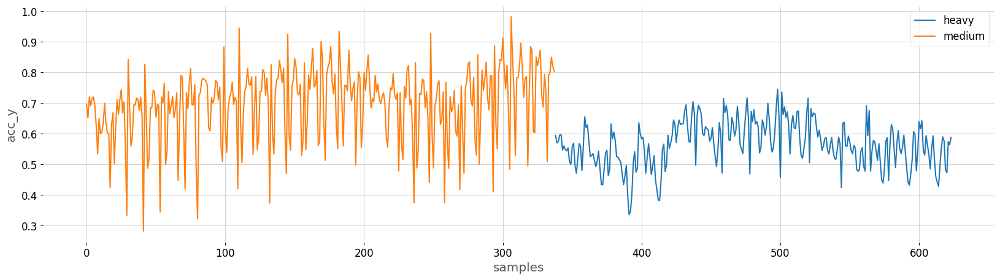

In [22]:
#compare medium and heavy sets

squat_category_df = df.query("label == 'squat'").query(" participent == 'A'").reset_index()


fig, ax = plt.subplots()
squat_category_df.groupby(['category'])['acc_y'].plot()
ax.set_ylabel('acc_y')
ax.set_xlabel('samples')
plt.legend()

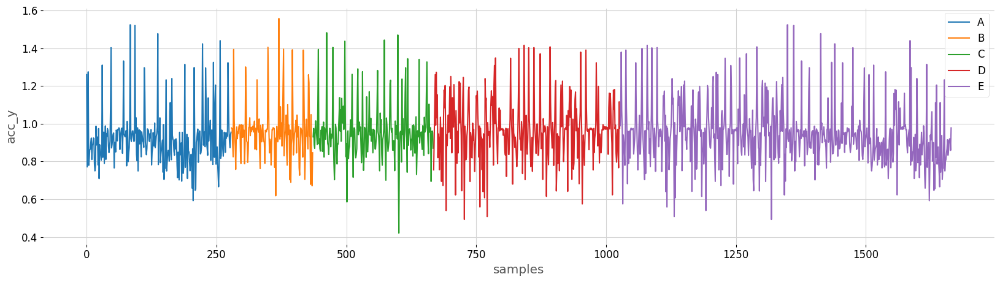

In [31]:
#comparing Participents

participent_df = df.query("label == 'bench'").sort_values('participent').reset_index()


fig, ax = plt.subplots()
participent_df.groupby(['participent'])['acc_y'].plot()
ax.set_ylabel('acc_y')
ax.set_xlabel('samples')
plt.legend()

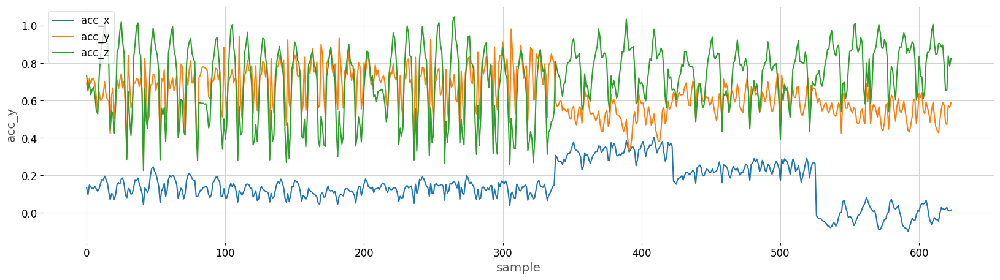

In [32]:
#lets plot squat for A with all acc data

label = 'squat'
participent = 'A'

all_axis_df = df.query(f"label== '{label}'").query(f"participent=='{participent}' ").reset_index()

fig, ax = plt.subplots()
all_axis_df[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax)
ax.set_ylabel("acc_y")
ax.set_xlabel("sample")
plt.legend()

C:\Users\ASUS PC\AppData\Local\Temp\ipykernel_7884\1837872814.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


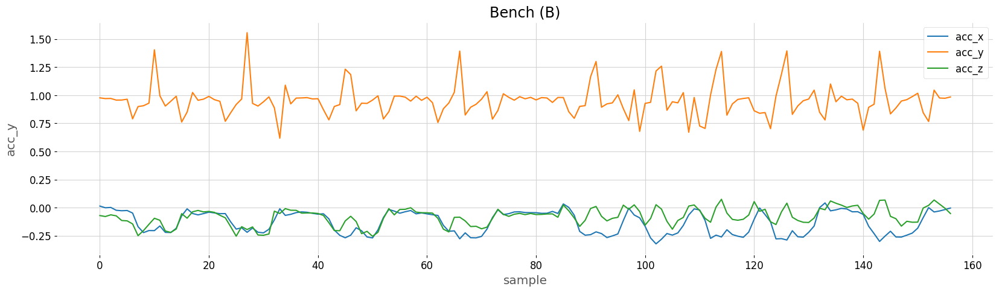

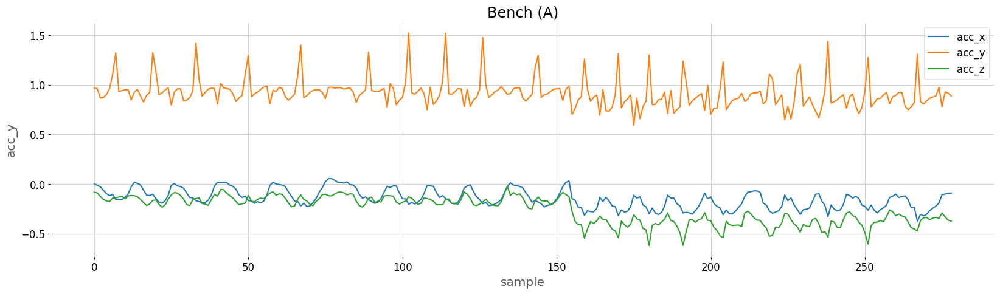

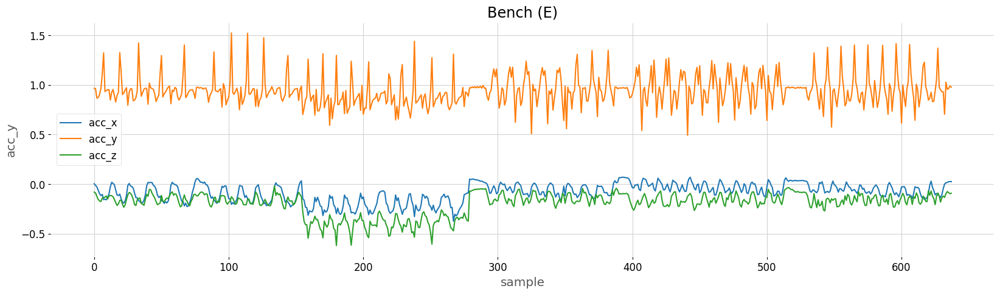

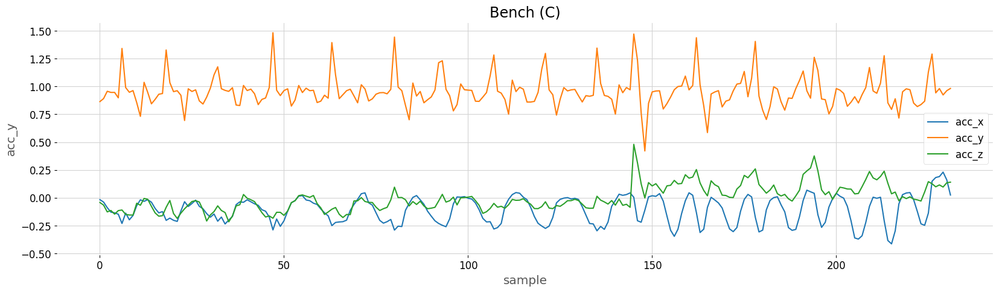

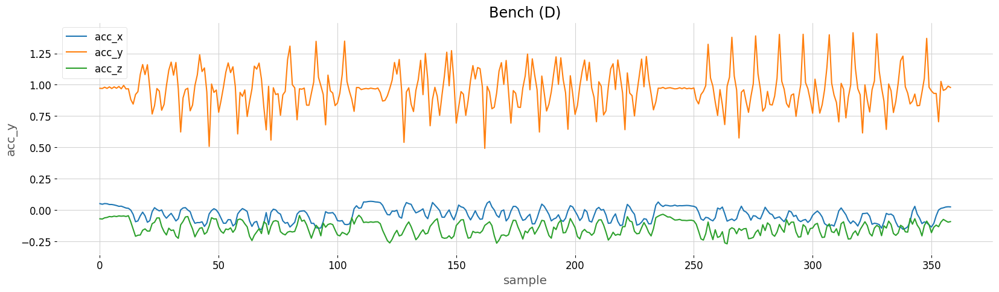

...

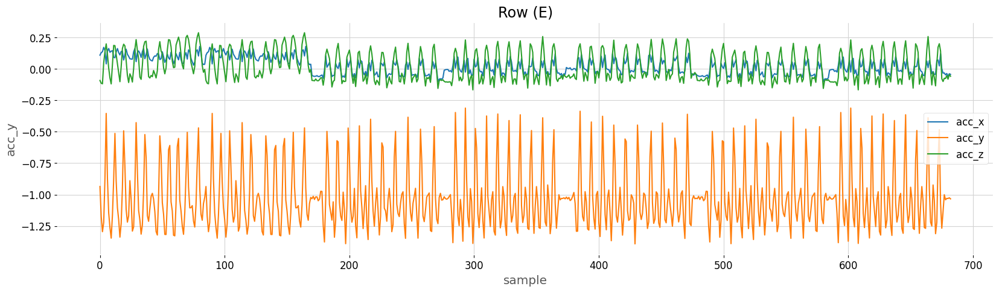

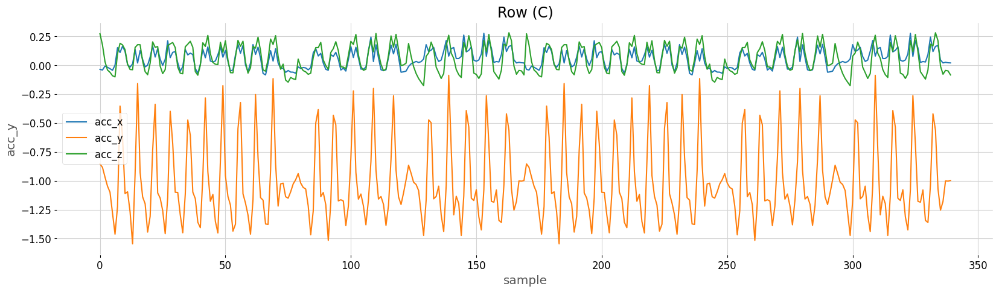

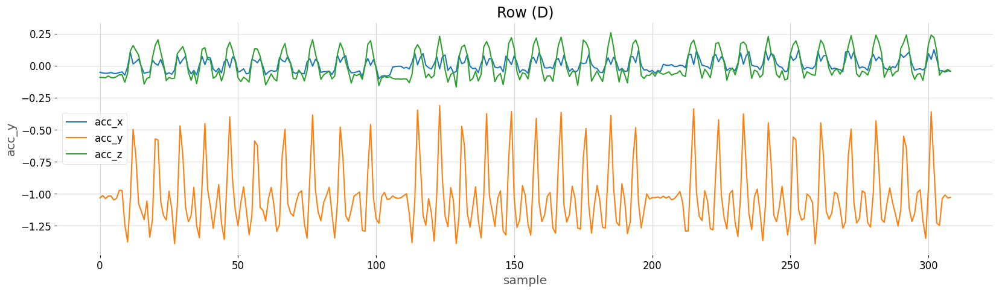

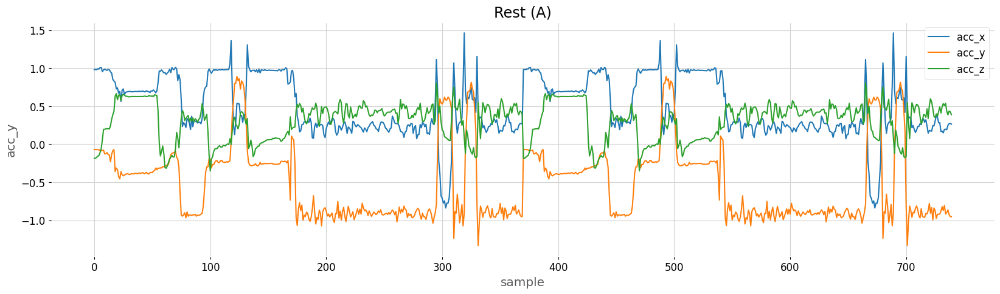

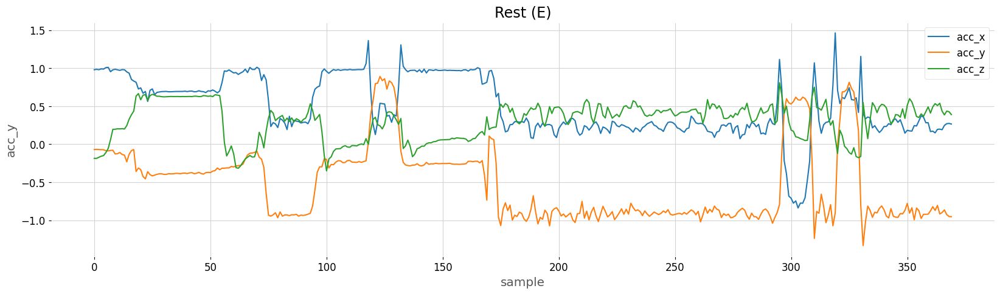

In [33]:
#creating plots for all the lable and participents for Accelerometer data

labels = df['label'].unique()
participents = df['participent'].unique()


for label in labels:
    for participent in participents:
        all_axis_df = (
            df.query(f"label== '{label}'")
            .query(f"participent=='{participent}' ")
            .reset_index()
        )
        
        if len(all_axis_df) > 0:
            
            fig, ax = plt.subplots()
            all_axis_df[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax)
            ax.set_ylabel("acc_y")
            ax.set_xlabel("sample")
            plt.title(f"{label} ({participent})".title())
            plt.legend()

C:\Users\ASUS PC\AppData\Local\Temp\ipykernel_7884\2637103056.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


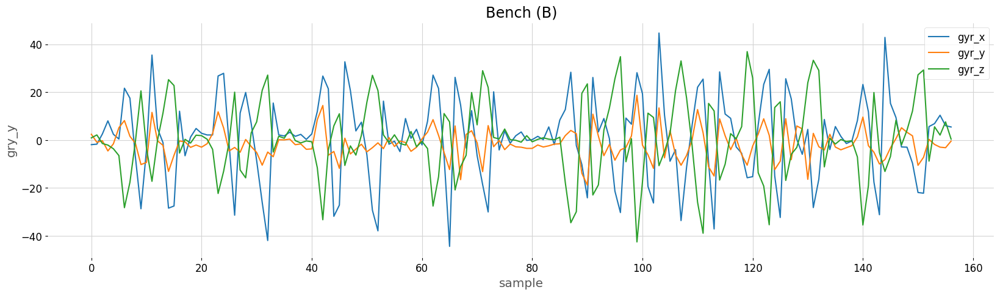

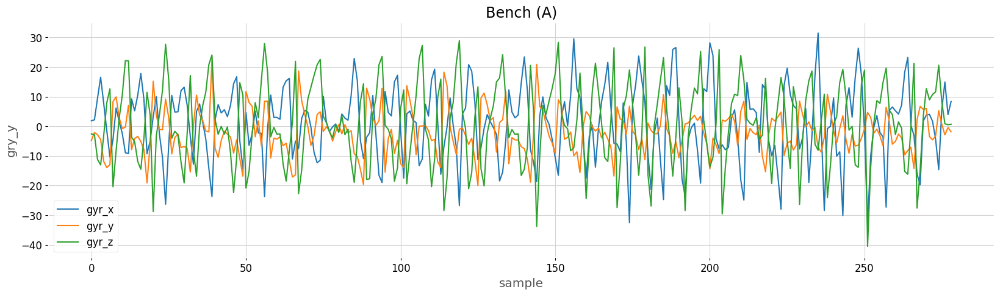

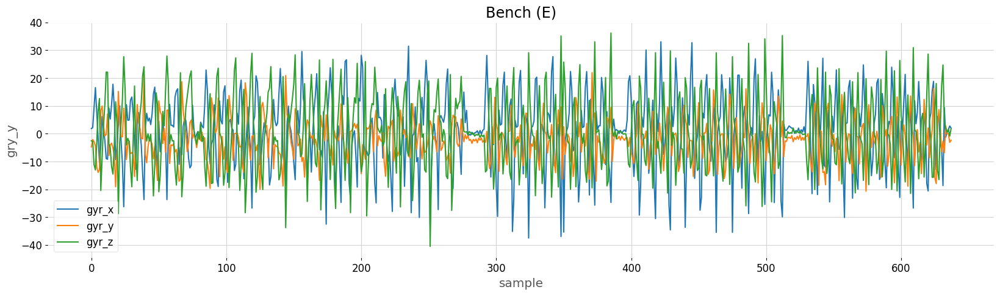

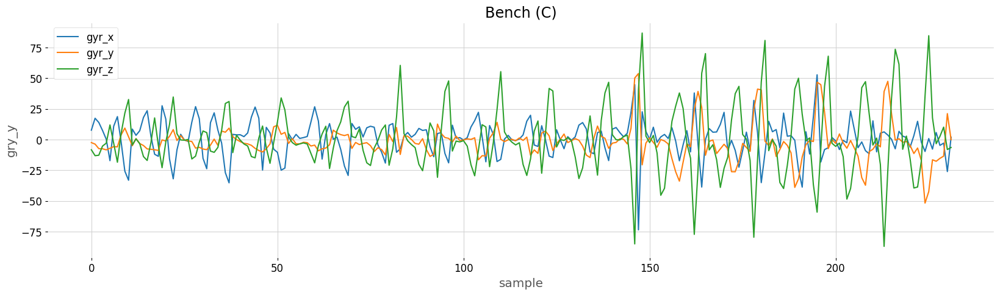

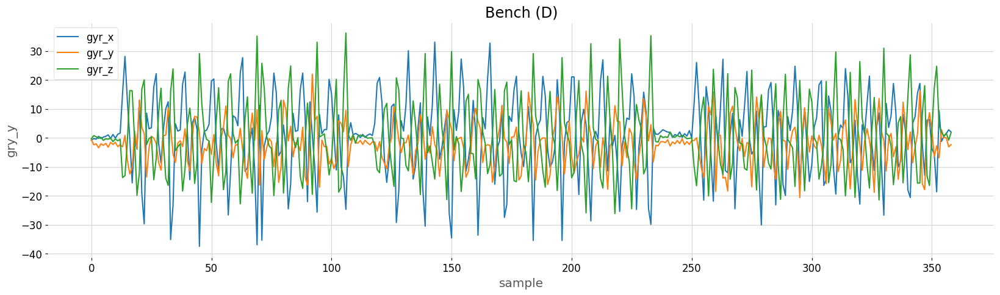

...

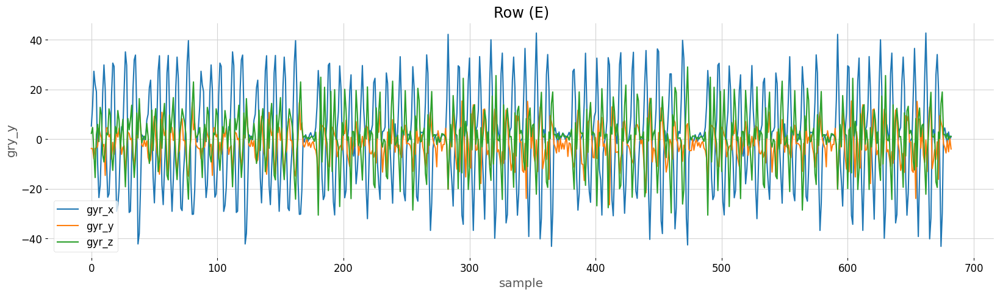

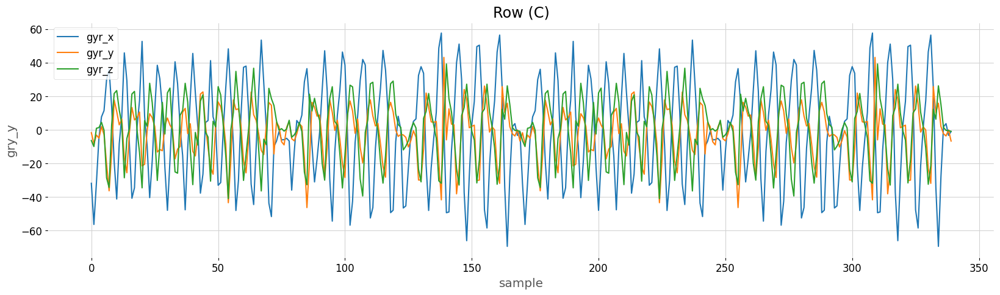

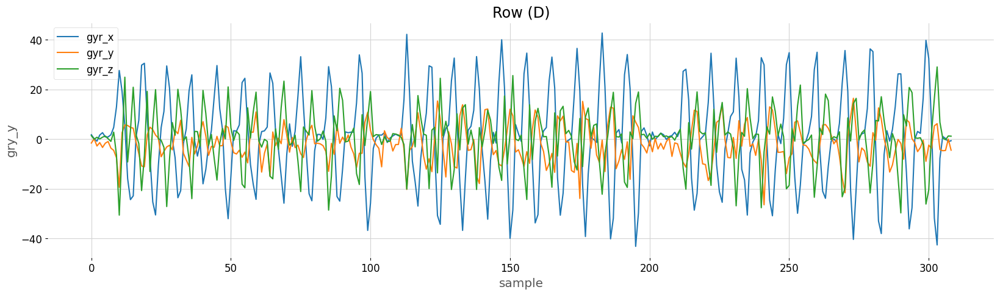

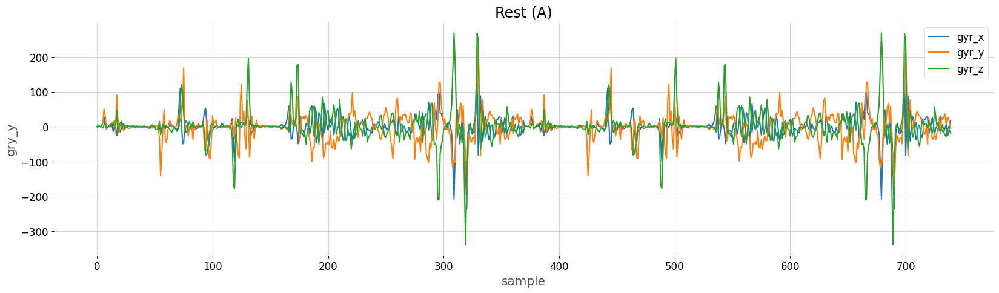

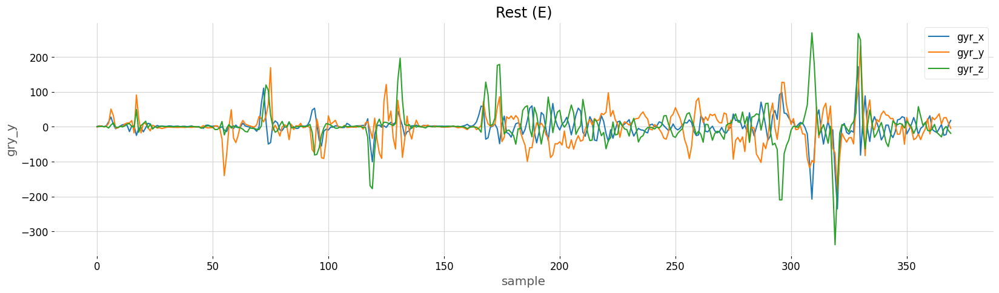

In [35]:
#creating plots for all the lable and participents for Gryroscope data

labels = df['label'].unique()
participents = df['participent'].unique()


for label in labels:
    for participent in participents:
        all_axis_df = (
            df.query(f"label== '{label}'")
            .query(f"participent=='{participent}' ")
            .reset_index()
        )
        
        if len(all_axis_df) > 0:
            
            fig, ax = plt.subplots()    #if you press ctrl+RMC on subplot it will open official doc of that func
            all_axis_df[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax=ax)
            ax.set_ylabel("gry_y")
            ax.set_xlabel("sample")
            plt.title(f"{label} ({participent})".title())
            plt.legend()

Text(0.5, 0, 'sample')

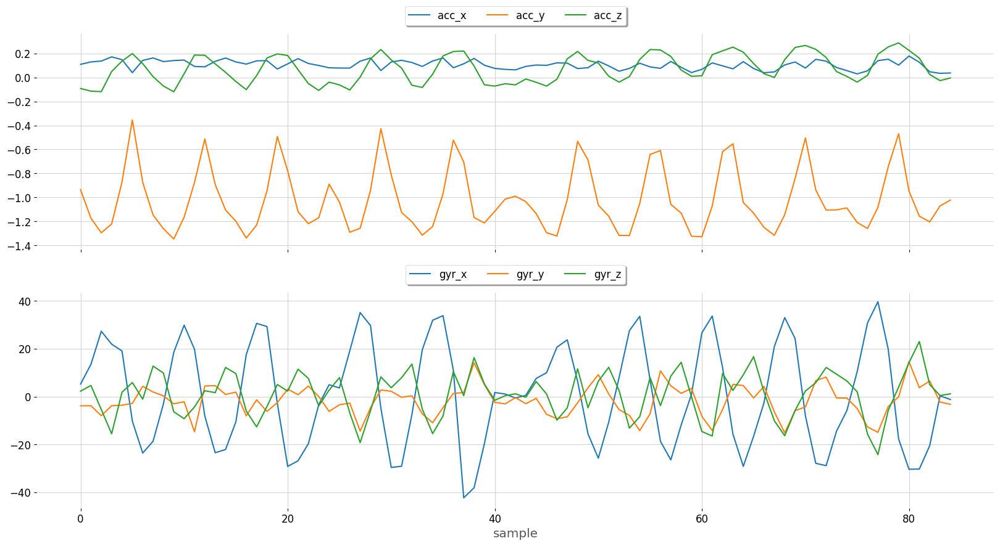

In [36]:
#combine plot in 1 fig

label = 'row'
participent = 'A'

combined_plot_df = (df.query(f"label== '{label}'")
               .query(f"participent=='{participent}' ")
               .reset_index())

fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20,10))
combined_plot_df[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax[0])
combined_plot_df[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax=ax[1])

ax[0].legend(loc="upper center", bbox_to_anchor=(0.5,1.15), ncol=3, fancybox=True, shadow=True)
ax[1].legend(loc="upper center", bbox_to_anchor=(0.5,1.15), ncol=3, fancybox=True, shadow=True)
ax[1].set_xlabel("sample")


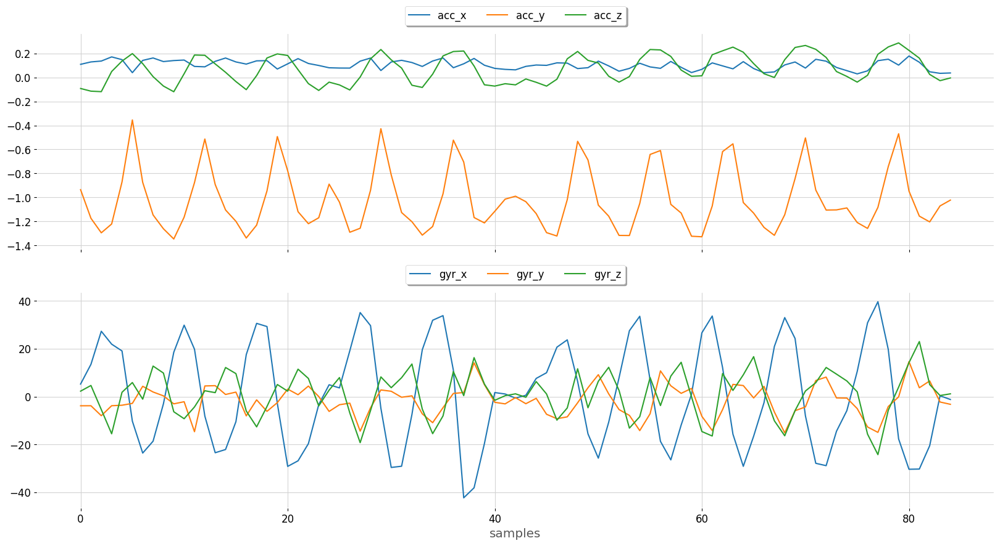

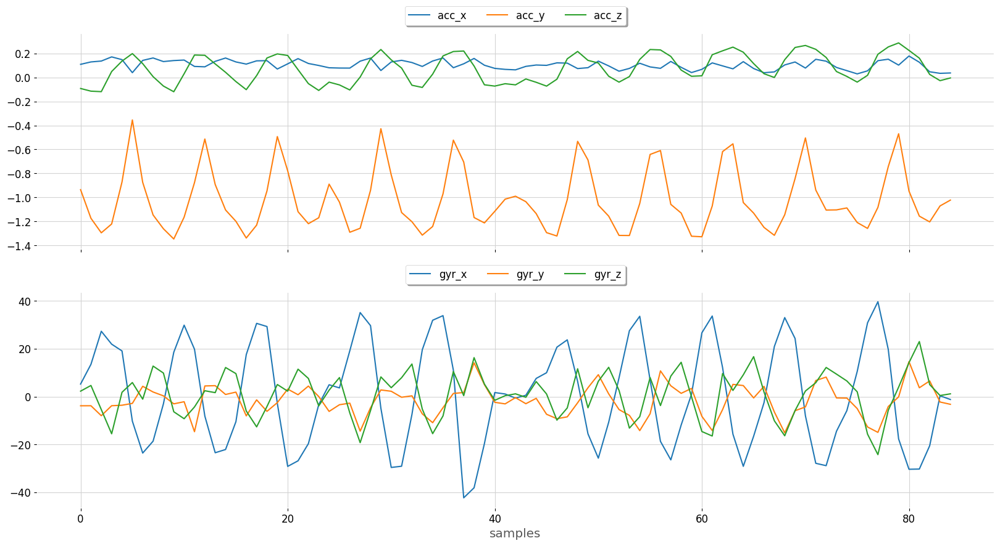

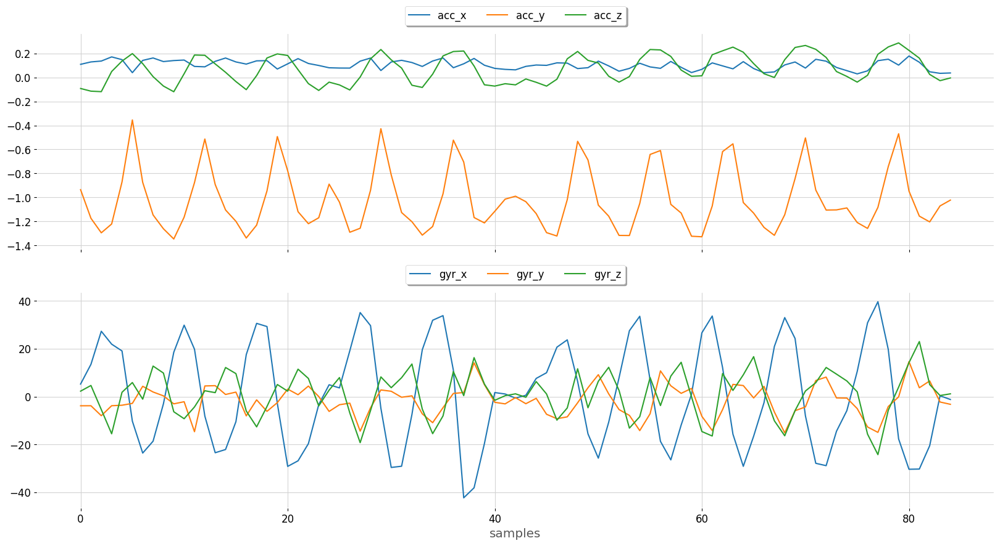

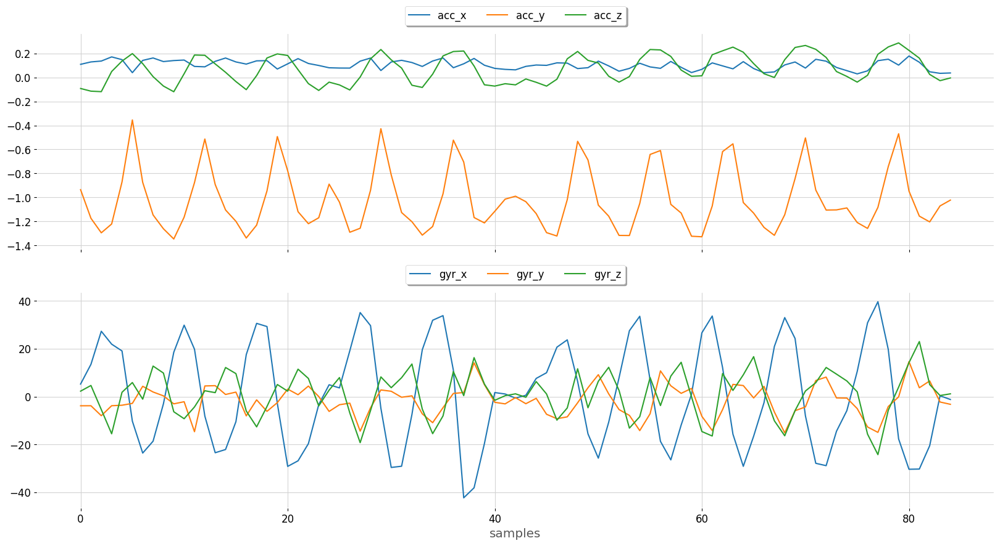

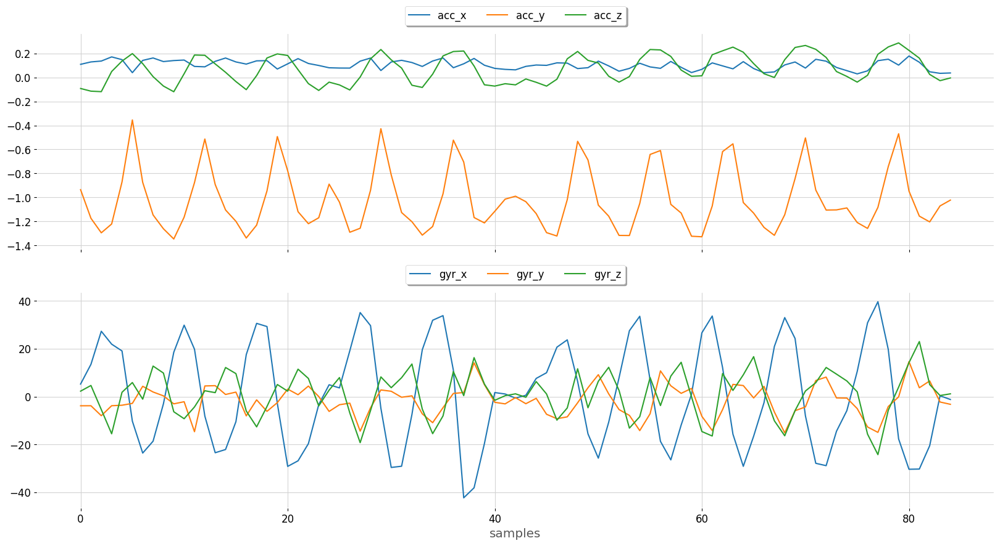

...

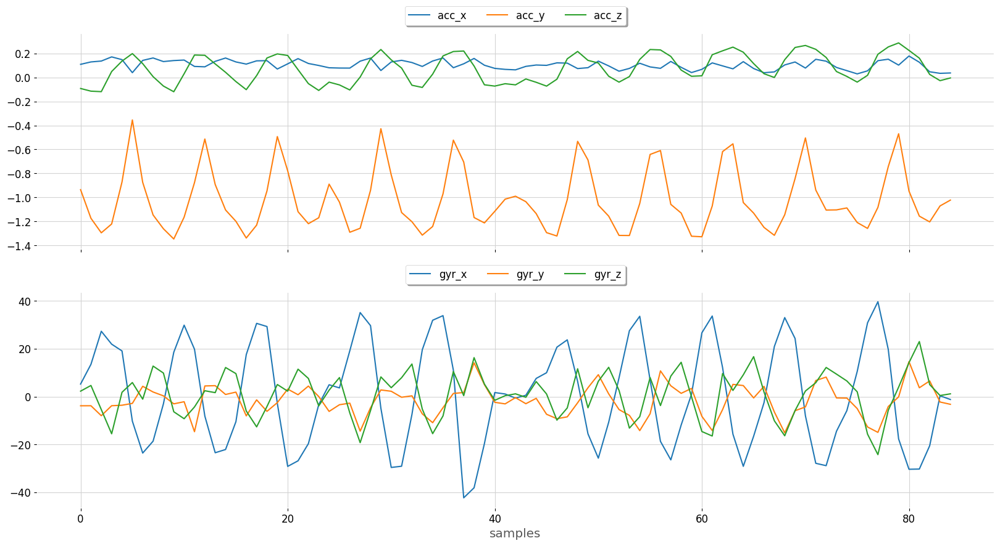

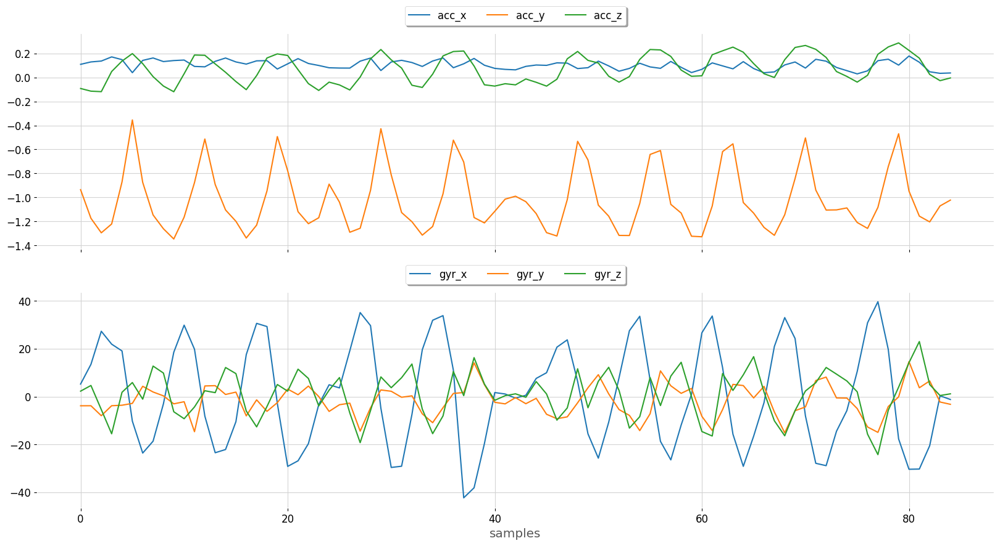

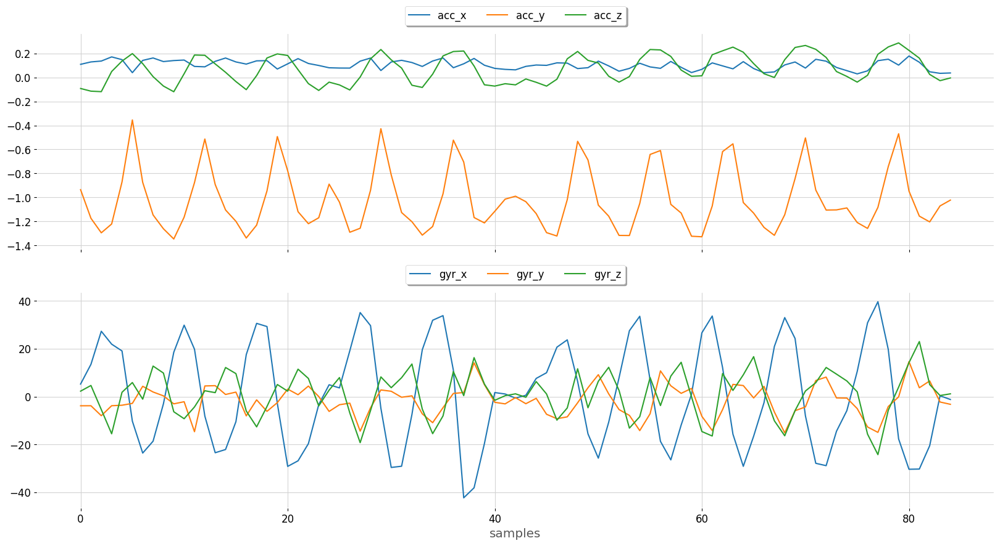

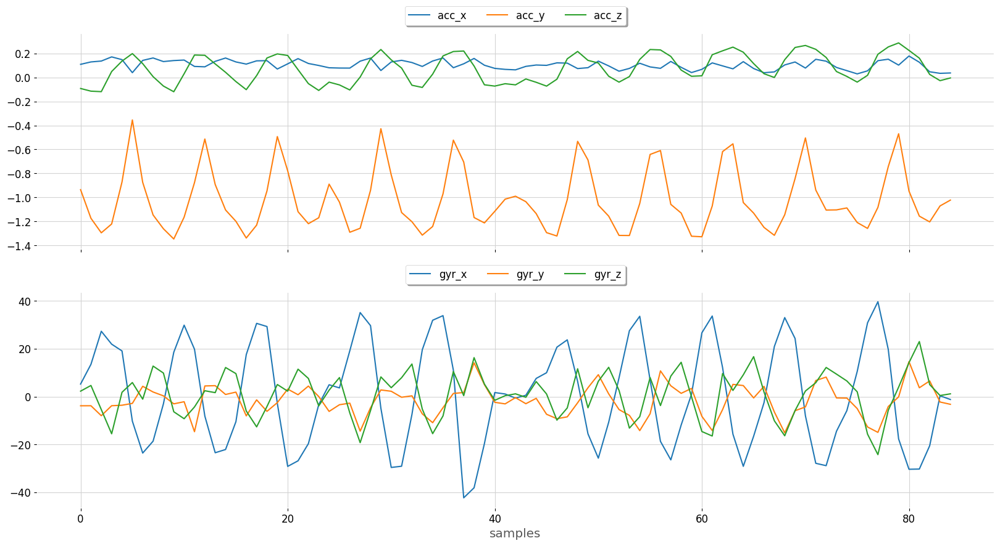

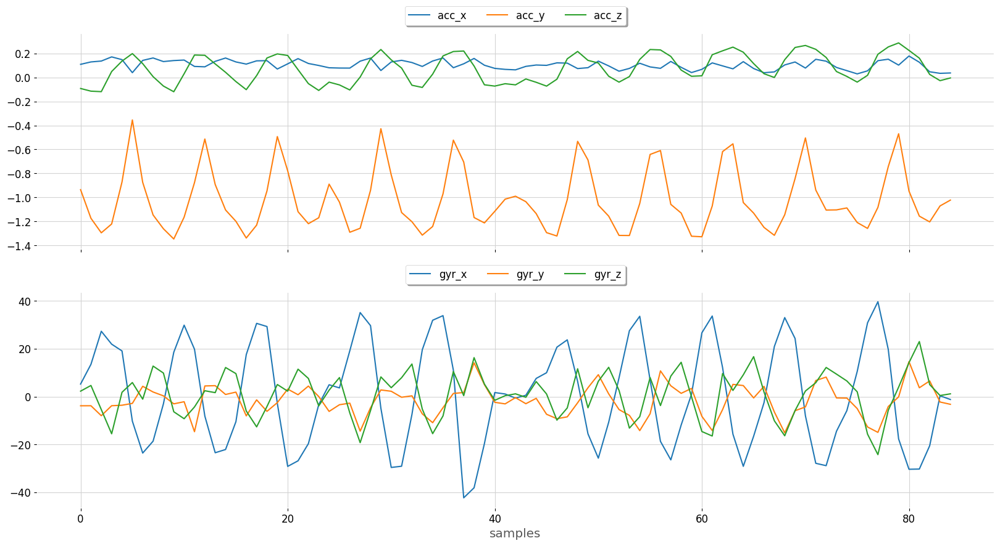

In [37]:
#combined all the figures for acc and gyr data

#creating plots for all the lable and participents for Gryroscope data

labels = df['label'].unique()
participents = df['participent'].unique()


for label in labels:
    for participent in participents:
        all_axis_df = (
            df.query(f"label== '{label}'")
            .query(f"participent=='{participent}' ")
            .reset_index()
        )
        
        if len(all_axis_df) > 0:
            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20,10))
            combined_plot_df[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax[0])
            combined_plot_df[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax=ax[1])
            
            ax[0].legend(loc="upper center", bbox_to_anchor=(0.5,1.15), ncol=3, fancybox=True, shadow=True)
            ax[1].legend(loc="upper center", bbox_to_anchor=(0.5,1.15), ncol=3, fancybox=True, shadow=True)
            ax[1].set_xlabel("samples")
            
            plt.savefig(f"../../reports/figures/{label.title()} ({participent}).png")
            plt.show()